<!DOCTYPE html>
<html>
<body>
 <h1>Background Subtraction</h1>
 <h3>How to Use Background Subtraction Methods</h3>
<p>Background subtraction (BS) is a common and widely used technique for generating a foreground mask (namely, a binary image containing the pixels belonging to moving objects in the scene) by using static cameras.

As the name suggests, BS calculates the foreground mask performing a subtraction between the current frame and a background model, containing the static part of the scene or, more in general, everything that can be considered as background given the characteristics of the observed scene.</p>
<img src="C:\Users\sinch\Downloads\bs.png">
</body>
</html>


Image file found at C:\Users\sinch\Downloads\Background_Subtraction_Tutorial_frame_1.png


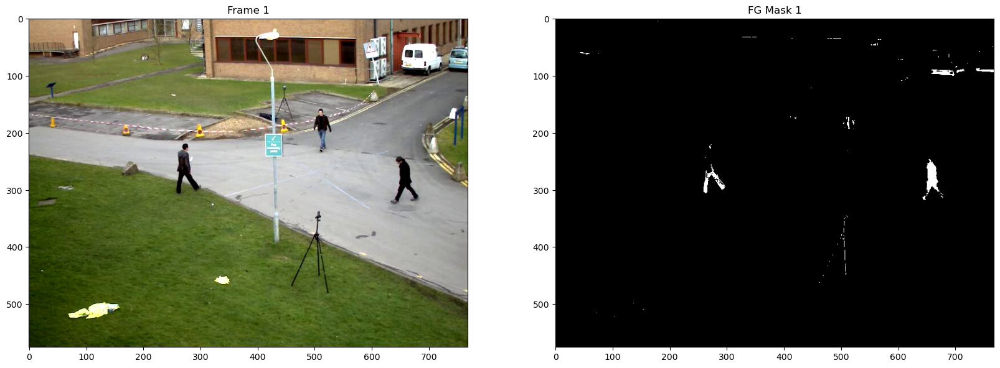

In [24]:
import cv2
import matplotlib.pyplot as plt
import os

# Choose the background subtraction algorithm
algo = 'MOG2'

if algo == 'MOG2':
    backSub = cv2.createBackgroundSubtractorMOG2()
else:
    backSub = cv2.createBackgroundSubtractorKNN()

# Define image paths
image_path_1 = r'C:\Users\sinch\Downloads\Background_Subtraction_Tutorial_frame_1.png'


# Check if the image files exist
if not os.path.exists(image_path_1):
    print(f"Error: Image file not found at {image_path_1}")
else:
    print(f"Image file found at {image_path_1}")



# Load and process the first image
frame_1 = cv2.imread(image_path_1)
if frame_1 is None:
    print(f"Error: Failed to load the image from {image_path_1}")
else:
    fgMask_1 = backSub.apply(frame_1)

    plt.figure(figsize=(20, 20))
    plt.subplot(2, 2, 1)
    plt.title("Frame 1")
    plt.imshow(cv2.cvtColor(frame_1, cv2.COLOR_BGR2RGB))  # Convert BGR to RGB for display
    plt.subplot(2, 2, 2)
    plt.title("FG Mask 1")
    plt.imshow(fgMask_1, cmap='gray')  # Use cmap='gray' for the single-channel mask


# Show the plots
plt.show()


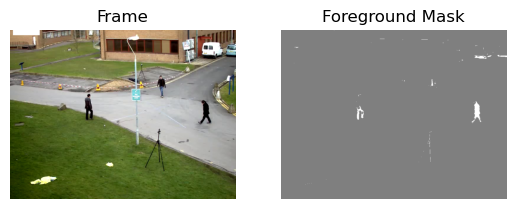

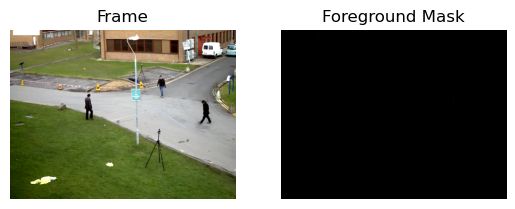

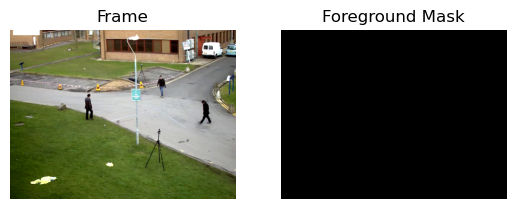

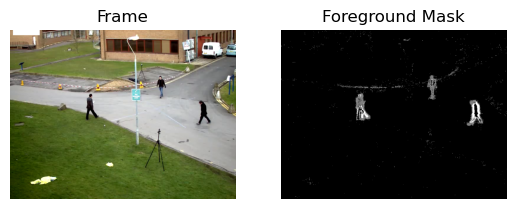

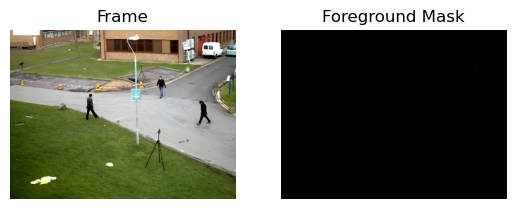

...

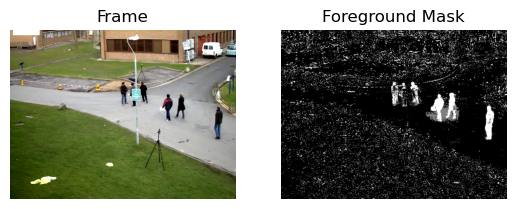

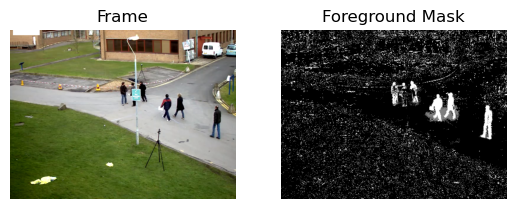

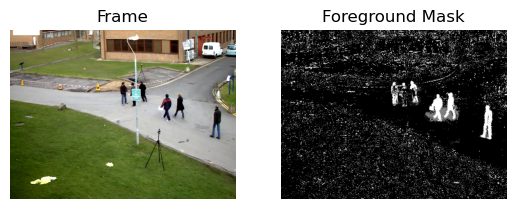

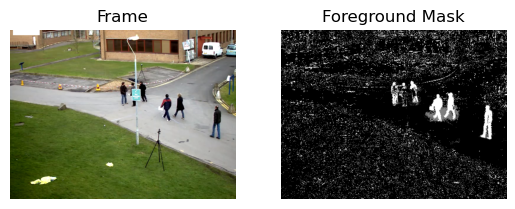

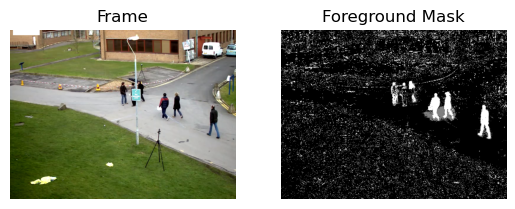

In [19]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

# Set the algorithm and video input path
algo = 'MOG2'
inputt = r'C:\Users\sinch\Downloads\Background_Subtraction_Tutorial_frame.mp4'

# Open the video capture
capture = cv2.VideoCapture(inputt)
frame_width = int(capture.get(3))  # Width of the frames
frame_height = int(capture.get(4))  # Height of the frames

# Prepare video writer to save output
out = cv2.VideoWriter('Background_Subtraction_Tutorial_frame_output.mp4', cv2.VideoWriter_fourcc('M','J','P','G'), 30, (frame_width, frame_height))

# Initialize background subtractor
if algo == 'MOG2':
    backSub = cv2.createBackgroundSubtractorMOG2()
else:
    backSub = cv2.createBackgroundSubtractorKNN()

# Start processing the video
while True:
    ret, frame = capture.read()
    
    if not ret:
        break  # Stop when the video ends
    
    # Apply background subtraction
    fgMask = backSub.apply(frame)
    
    # Optionally add a rectangle to the frame
    cv2.rectangle(frame, (10, 2), (100, 20), (255, 255, 255), -1)

    # Convert frame and mask to RGB for matplotlib (OpenCV uses BGR)
    frame_rgb = cv2.cvtColor(frame, cv2.COLOR_BGR2RGB)
    fgMask_colored = cv2.cvtColor(fgMask, cv2.COLOR_GRAY2RGB)
    
    # Display the original frame and foreground mask using matplotlib
    plt.subplot(1, 2, 1)
    plt.imshow(frame_rgb)
    plt.title('Frame')
    plt.axis('off')

    plt.subplot(1, 2, 2)
    plt.imshow(fgMask_colored)
    plt.title('Foreground Mask')
    plt.axis('off')

    # Display the plots
    plt.draw()
    plt.pause(0.001)  # Pause to allow the plot to update

    # Write the result to output video file (ensure it's in the same format)
    out.write(fgMask_colored)
    
    # You can stop the loop manually by interrupting the kernel or by adding custom logic
    # to check for a keyboard interrupt. In Jupyter, this would involve using the "stop" button.

# Release resources
capture.release()
out.release()
plt.close()
